### Importing necessary libraries

In [1]:
import numpy as np
from matplotlib import pyplot as plt
import librosa
import librosa.display
import skimage.io
import os
import cv2
from pydub import AudioSegment
import tensorflow as tf
from tensorflow import keras
from keras.layers import Dense, Conv2D, MaxPool2D, MaxPooling2D, BatchNormalization, Flatten, Dropout, ZeroPadding2D, concatenate, Input
from keras.models import Model
from keras import regularizers
from sklearn.model_selection import train_test_split

C:\ProgramData\Anaconda3\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,
C:\ProgramData\Anaconda3\lib\site-packages\pydub\utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


In [2]:
# to run matplotlib in jupyter properly
os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'

In [3]:
# path to datasest
trainDB = "Mosaic23_PS1_TrainData/ICBHI_final_database"

# list of all files
train_files = os.listdir(trainDB)

In [4]:
# seperating txt and audio files into seperate lists

wav_files = []
txt_files = []

for trfile in train_files:
    if trfile[-3:] == "txt":
        txt_files.append(trfile)
    elif trfile[-3:] == "wav":
        wav_files.append(trfile)

In [5]:
# getting breathing cycle and wheeze, crackle data from the text files

breathing_cycles = {}
crackle_wheeze = {}

for txfile in txt_files:
    txpath = os.path.join(trainDB, txfile)
    t = open(txpath, 'r')
    content = t.readlines()
    breathing_cycles[txfile[:-4]] = []
    crackle_wheeze[txfile[:-4]] = []
    
    for line in content:
        data = line[:-1].split("\t")
        breathing_cycles[txfile[:-4]].append((data[0], data[1]))
        crackle_wheeze[txfile[:-4]].append((data[2], data[3]))

### Dividing audio files into seperate on basis of timestamps for breathing cycle

In [6]:
os.mkdir("parted_audfiles")

for wfile in wav_files:
    wf_path = os.path.join(trainDB, wfile)
    bcs = breathing_cycles[wfile[:-4]]
    cws = crackle_wheeze[wfile[:-4]]
    i = 0
    
    for bc in bcs:
        i += 1
        start = float(bc[0]) * 1000
        end = float(bc[1]) * 1000
        
        AS = AudioSegment.from_wav(wf_path)
        AS = AS[start: end]
        AS.export("parted_audfiles/" + wfile[:-4] + "{}".format(i) + ".wav", format = "wav")

C:\ProgramData\Anaconda3\lib\site-packages\pydub\utils.py:198: RuntimeWarning: Couldn't find ffprobe or avprobe - defaulting to ffprobe, but may not work
  warn("Couldn't find ffprobe or avprobe - defaulting to ffprobe, but may not work", RuntimeWarning)


FileNotFoundError: [WinError 2] The system cannot find the file specified

In [6]:
# getting list of parted audiofile names from directory

part_wav_files = os.listdir("parted_audfiles")

In [7]:
# Storing extra features obtained from file name to dictionary

extra_feats = {}
cls = {'Ar': 0, 'Tc': 1, 'Al': 2, 'Pl': 3, 'Pr': 4, 'Ll': 5, 'Lr': 6}
re = {'LittC2SE': 0, 'Meditron': 1, 'Litt3200': 2, 'AKGC417L': 3}

for pwfile in part_wav_files:
    pwpath = os.path.join(trainDB, pwfile)
    extra_feats[pwfile] = []
    
    extra_feats[pwfile].extend([cls[pwfile[8: 10]], re[pwfile[14: 22]]])

In [8]:
# converting the features to list

hard_feats = np.array(list(extra_feats.values()))

In [9]:
hard_feats

array([[0, 0],
       [0, 0],
       [0, 0],
       ...,
       [3, 0],
       [3, 0],
       [3, 0]])

### Getting spectrograms from parted audiofiles to train

C:\Users\Dhruv Sharma\AppData\Local\Temp\ipykernel_10580\4092265112.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


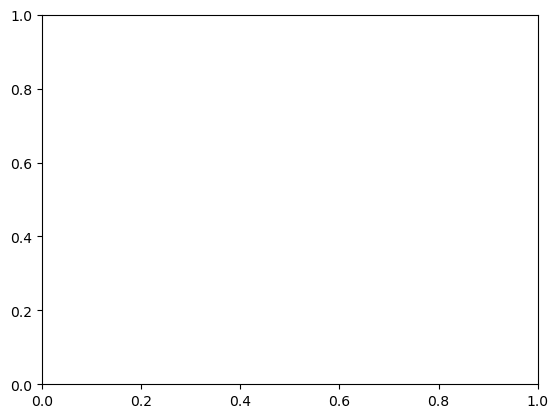

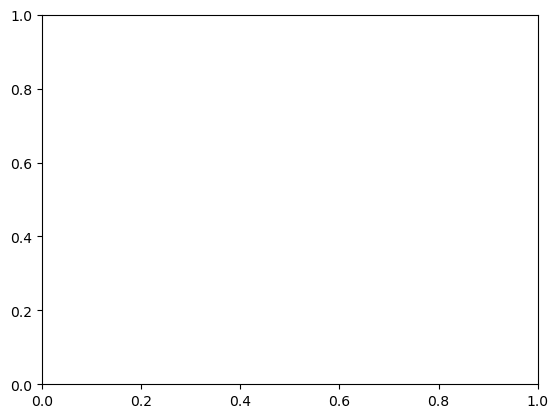

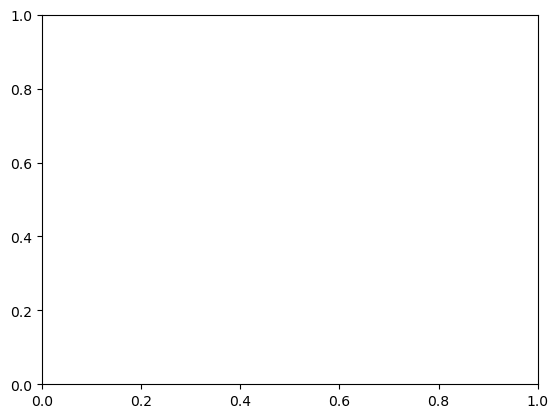

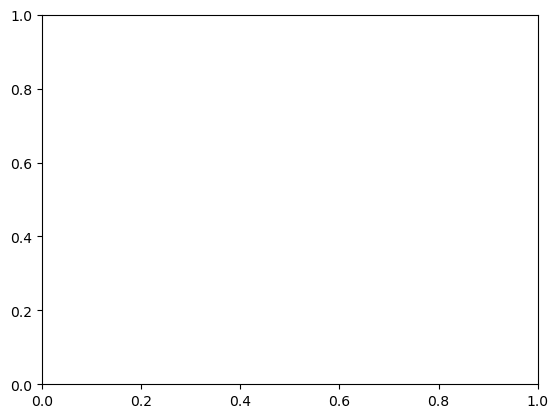

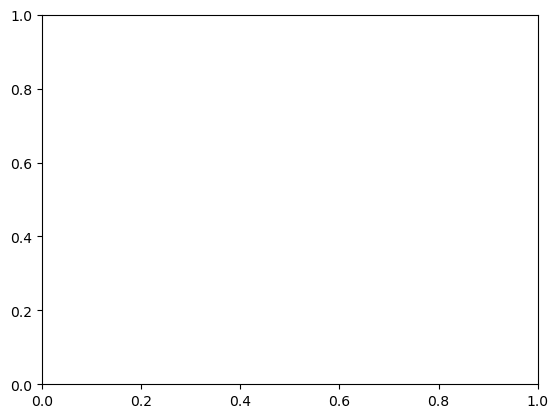

...

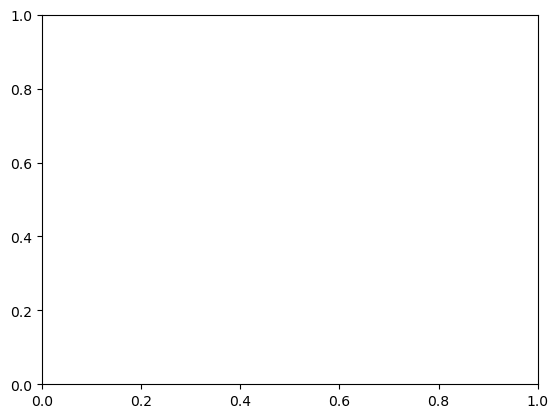

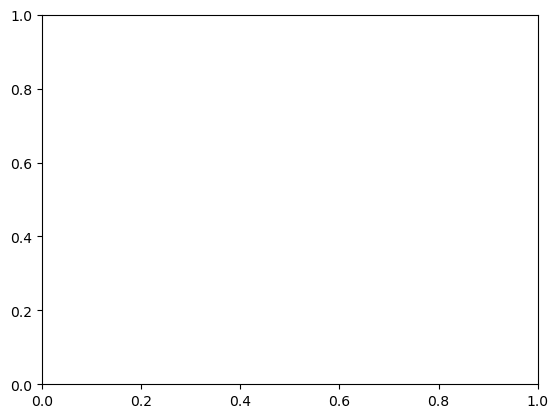

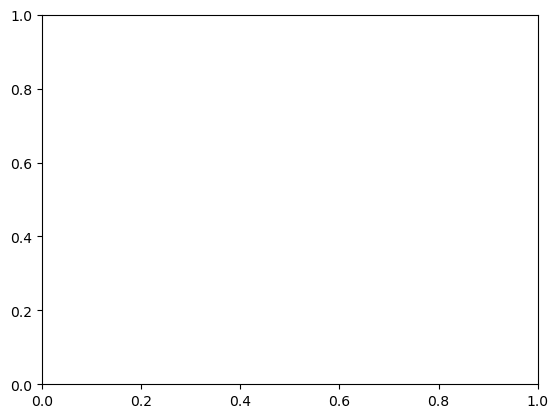

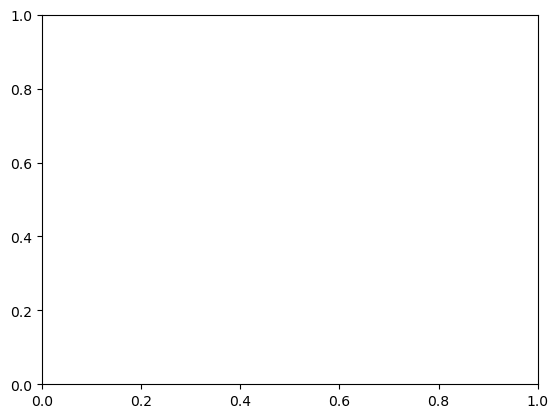

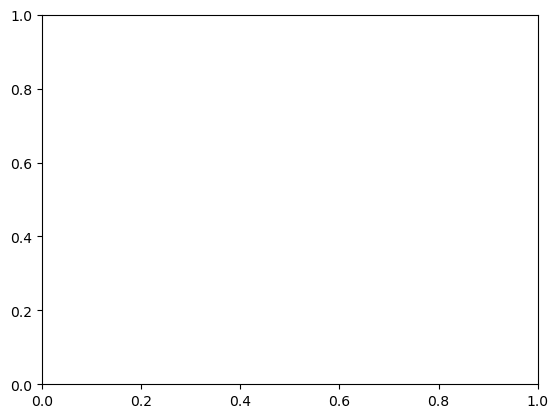

Error in callback <function flush_figures at 0x000001F455BC2B80> (for post_execute):


KeyboardInterrupt: 

In [28]:
os.mkdir("parted_spectrograms")

def scale_minmax(X, min=0.0, max=1.0):
    X_std = (X - X.min()) / (X.max() - X.min())
    X_scaled = X_std * (max - min) + min
    return X_scaled

spectrograms = []
srs = []

for pwfile in part_wav_files:
    pwf_path = os.path.join("parted_audfiles", pwfile)
    aud, sr = librosa.load(pwf_path)
    
    S = librosa.feature.melspectrogram(y=aud, sr=sr, n_mels=128, fmax=8000, hop_length=512)
    
    fig, ax = plt.subplots()
    S_dB = librosa.power_to_db(S, ref=np.max)
    S_dB = scale_minmax(S_dB, 0, 255).astype(np.uint8)
    S_dB = np.flip(S_dB, axis = 0)
    S_dB = 255 - S_dB
    S_dB = cv2.resize(S_dB, (128, 128), interpolation = cv2.INTER_CUBIC)

    skimage.io.imsave("parted_spectrograms/" + pwfile[:-4] + "spec.png", S_dB)

In [10]:
# list of parted spectrograms from directory
pspecs = os.listdir("parted_spectrograms")

### Creating dataset, x -> spectrogram images, y -> labels in form [crackle_presence, wheeze_presence]

In [11]:
X_specs = []
Y_labels = []

for pspec in pspecs:
    pspec_img = cv2.imread(os.path.join("parted_spectrograms", pspec))
    X_specs.append(pspec_img)

for sfile in wav_files:
    cws = crackle_wheeze[sfile[:-4]]
    for cw in cws:
        Y_labels.append(np.array(cw).astype("float32"))

In [12]:
# Normalizing the data
for i in range(len(X_specs)):
    X_specs[i] = X_specs[i] / 255.0
    X_specs[i] = X_specs[i].reshape(X_specs[i].shape[0:3])
    X_specs[i] = np.array(X_specs[i].astype("float32"))
    
    Y_labels[i] = Y_labels[i].reshape(Y_labels[i].shape[0: 2])

In [13]:
X_specs[0].shape

(128, 128, 3)

In [14]:
# dividing into train and test datasets

X_train, X_test, Y_train, Y_test = train_test_split(list(zip(X_specs, hard_feats)), Y_labels, test_size = 0.2)

In [15]:
# dividing further to create test and validation dataset

X_test, X_val, Y_test, Y_val = train_test_split(X_test, Y_test, test_size = 0.5)

In [16]:
# Dividing train x set into spectrogram and extra features from file names

train_hard = []
train_x = []
test_hard = []
test_x = []
val_hard = []
val_x = []

for e in X_train:
    train_hard.append(e[1])
    train_x.append(e[0])

for e in X_test:
    test_hard.append(e[1])
    test_x.append(e[0])
    
for e in X_val:
    val_hard.append(e[1])
    val_x.append(e[0])

In [17]:
# converting all into numpy array

train_hard = np.array(train_hard)
train_x = np.array(train_x)
test_hard = np.array(test_hard)
test_x = np.array(test_x)
val_hard = np.array(val_hard)
val_x = np.array(val_x)

### Creating CNN model

In [18]:
def conv_block():
    return keras.Sequential([
        ZeroPadding2D(padding = (1, 1)),
        Conv2D(64, 3, padding = "valid", activation = "ReLU"),
        BatchNormalization(axis = -1),
        MaxPool2D(pool_size = 2)
    ])

inputs = Input(shape = (128, 128, 3))
hard_feats = Input(shape = (1, ))
x = conv_block()(inputs)
x = conv_block()(x)
x = conv_block()(x)
x = conv_block()(x)
x = Flatten()(x)
x = Dense(32)(x)
x = concatenate([x, hard_feats])
x = BatchNormalization(axis = -1)(x)
x = Dense(2, activation = "sigmoid")(x)

model = Model(inputs = [inputs, hard_feats], outputs = [x])


In [19]:
optimizer = keras.optimizers.SGD(lr = 0.005)

C:\ProgramData\Anaconda3\lib\site-packages\keras\optimizers\optimizer_v2\gradient_descent.py:111: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [20]:
model.compile(optimizer = optimizer, loss = "BinaryCrossentropy", metrics = ["AUC"])

### Training model

In [34]:
model.fit([train_x, train_hard[:, 0]], np.array(Y_train), batch_size = 32, epochs = 4, verbose = 1, validation_data = [[val_x, val_hard[:, 0]], np.array(Y_val)])

Epoch 1/4
153/153 [==============================] - 206s 1s/step - loss: 0.3900 - auc: 0.8840 - val_loss: 0.6426 - val_auc: 0.7316
Epoch 2/4
153/153 [==============================] - 215s 1s/step - loss: 0.3728 - auc: 0.8951 - val_loss: 0.5657 - val_auc: 0.7522
Epoch 3/4
153/153 [==============================] - 209s 1s/step - loss: 0.3444 - auc: 0.9141 - val_loss: 0.5576 - val_auc: 0.7297
Epoch 4/4
153/153 [==============================] - 206s 1s/step - loss: 0.3276 - auc: 0.9220 - val_loss: 0.5206 - val_auc: 0.7595


In [35]:
# saving to model file

model.save_weights("live_model2.pt")

### testing the obtained model on test set

In [28]:
def conv_block():
    return keras.Sequential([
        ZeroPadding2D(padding = (1, 1)),
        Conv2D(64, 3, padding = "valid", activation = "ReLU"),
        BatchNormalization(axis = -1),
        MaxPool2D(pool_size = 2)
    ])

inputs = Input(shape = (128, 128, 3))
hard_feats = Input(shape = (1, ))
x = conv_block()(inputs)
x = conv_block()(x)
x = conv_block()(x)
x = conv_block()(x)
x = Flatten()(x)
x = Dense(32)(x)
x = concatenate([x, hard_feats])
x = BatchNormalization(axis = -1)(x)
x = Dense(2, activation = "sigmoid")(x)

test_model = Model(inputs = [inputs, hard_feats], outputs = [x])

In [29]:
test_model.load_weights("live_model.pt")

In [30]:
test_model.compile(optimizer = optimizer, loss = "BinaryCrossentropy", metrics = ["accuracy"])

In [31]:
test_model.evaluate([test_x, test_hard[:, 0]], np.array(Y_test), batch_size = 32)

20/20 [==============================] - 6s 289ms/step - loss: 0.6146 - accuracy: 0.8852


[0.6145575642585754, 0.8852459192276001]